<a href="https://colab.research.google.com/github/0530hwi/CatchingDudeoji/blob/main/Final_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0 준비사항

## 0.1 한글 폰트 설치

실행 -> 런타임 초기화 -> 주석처리 -> 아래 코드 제외 후 실행

In [ ]:
# !sudo apt-get install -y fonts-nanum
# !sudo fc-cache -fv
# !rm ~/.cache/matplotlib -rf

In [ ]:
!ls /usr/share/fonts/truetype/nanum

NanumBarunGothicBold.ttf  NanumMyeongjoBold.ttf  NanumSquareRoundR.ttf
NanumBarunGothic.ttf	  NanumMyeongjo.ttf	 NanumSquareR.ttf
NanumGothicBold.ttf	  NanumSquareB.ttf
NanumGothic.ttf		  NanumSquareRoundB.ttf


## 0.2 필요한 모듈 불러오기

In [ ]:
# 기본적인 라이브러리
import numpy as np
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
from google.colab import data_table
data_table.enable_dataframe_formatter()

# 시각화를 위한 라이브러리
import missingno as msno
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
plt.style.use('fivethirtyeight')
plt.rc('font', family='NanumBarunGothic')

import seaborn as sns
sns.set(font="NanumBarunGothic", 
        rc={"axes.unicode_minus":False},
        style='darkgrid',
        font_scale=2.0)

# 시계열 분석을 위한 라이브러리
import math
import statsmodels.api as sm
from numpy.random import normal, seed
from scipy.stats import norm
from statsmodels.tsa.arima_model import ARMA
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima_process import ArmaProcess
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_squared_error

# 1 데이터 불러오기 및 확인하기

## 1.1 데이터 불러오기

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/[해커톤] 낮잠, 수요지리분석/DATA/drive-download-20211027T031523Z-001/20211022_sample_hackathon_data.csv'\
                 , encoding='cp949')

df_copy = df.copy()

In [ ]:
data_table.DataTable(df, include_index=False, num_rows_per_page=10)

,region1,region2,reservation_return_at,reservation_start_at,age_group,gender,car_model
0,울산광역시,남구,2019-09-29 21:25:40+00:00,2019-09-29 19:20:00+00:00,1,male,경형
1,울산광역시,남구,2019-07-13 13:11:21+00:00,2019-07-13 11:00:00+00:00,1,male,준중형
2,울산광역시,남구,2019-09-16 23:43:08+00:00,2019-09-16 19:10:00+00:00,1,male,준중형
3,울산광역시,남구,2019-08-09 06:17:41+00:00,2019-08-09 00:20:00+00:00,1,male,준중형
4,울산광역시,남구,2019-07-24 12:36:29+00:00,2019-07-24 09:00:00+00:00,2,male,경형
...,...,...,...,...,...,...,...
457062,경기도,고양시 일산서구,2019-09-14 12:25:29+00:00,2019-09-14 12:00:00+00:00,1,male,경형
457063,경기도,고양시 일산서구,2019-07-25 15:30:00+00:00,2019-07-24 18:30:00+00:00,4,female,준중형
457064,경기도,고양시 일산서구,2019-07-14 22:38:09+00:00,2019-07-14 21:30:00+00:00,1,male,경형
457065,경기도,고양시 일산서구,2019-06-20 18:25:37+00:00,2019-06-20 18:10:00+00:00,1,unknown,소형SUV


## 1.2 데이터 정보 확인하기

In [ ]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 457067 entries, 0 to 457066
Data columns (total 7 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   region1                457067 non-null  object
 1   region2                457067 non-null  object
 2   reservation_return_at  457067 non-null  object
 3   reservation_start_at   457067 non-null  object
 4   age_group              457067 non-null  int64 
 5   gender                 457067 non-null  object
 6   car_model              457067 non-null  object
dtypes: int64(1), object(6)
memory usage: 24.4+ MB
None


* 데이터에 결측치는 존재하지 않는다.
* `reservation_return_at`, `reservation_start_at` 변수는 날짜 데이터이므로 Dtype을 datetime으로 바꿀 필요가 있다.

## 1.3 중복된 행의 여부 확인하기

In [ ]:
print([df.duplicated()] == True)

False


* 중복된 행이 없다는 것을 확인할 수 있다.

# 2 데이터 전처리

## 2.1 날짜 데이터 파싱하기

* 앞서 날짜 변수의 유형이 Object임을 확인했으므로, datetime으로 변환해야 한다.

In [ ]:
df.reservation_return_at = pd.to_datetime(df.reservation_return_at)
df.reservation_start_at = pd.to_datetime(df.reservation_start_at)

### 2.1.1 연도, 월, 일, 시간 파싱

In [ ]:
df['return_year'] = df['reservation_return_at'].dt.year
df['return_month'] = df['reservation_return_at'].dt.month
df['return_day'] = df['reservation_return_at'].dt.day
df['return_hour'] = df['reservation_return_at'].dt.hour
df['return_weekday'] = df['reservation_return_at'].dt.weekday

In [ ]:
df['start_year'] = df['reservation_start_at'].dt.year
df['start_month'] = df['reservation_start_at'].dt.month
df['start_day'] = df['reservation_start_at'].dt.day
df['start_hour'] = df['reservation_start_at'].dt.hour
df['start_weekday'] = df['reservation_start_at'].dt.weekday

## 2.2 사용시간이 음수인 데이터

* 반납시간 - 빌린시간이 음수인 경우가 있을 수 있다.
* 상식적으로 반납시간 > 빌린시간이 될 수 없기에 확인 후 제거하도록 한다.

In [ ]:
# 반납시간 - 빌린시간
df['use_time'] = df.reservation_return_at - df.reservation_start_at

use_total_hour = []
for i, time in enumerate(df.use_time):
    seconds = time.seconds
    hours = seconds // 3600
    use_total_hour.append(round(time.days * 24 + seconds/3600, 2))

In [ ]:
df['use_total_hr'] = use_total_hour
df['use_total_hr']

0          2.09
1          2.19
2          4.55
3          5.96
4          3.61
          ...  
457062     0.42
457063    21.00
457064     1.14
457065     0.26
457066     3.64
Name: use_total_hr, Length: 457067, dtype: float64

In [ ]:
minus_use_total_hr = []

for i, hr in enumerate(df.use_total_hr):
    if hr < 0:
        minus_use_total_hr.append(i)

print('총 사용시간 음수 데이터 개수:', len(minus_use_total_hr), '개')
df.iloc[minus_use_total_hr]

총 사용시간 음수 데이터 개수: 19 개


,region1,region2,reservation_return_at,reservation_start_at,age_group,gender,car_model,return_year,return_month,return_day,return_hour,return_weekday,start_year,start_month,start_day,start_hour,start_weekday,use_time,use_total_hr
19696,울산광역시,남구,2019-06-22 19:30:00+00:00,2019-06-22 20:20:00+00:00,1,male,준중형,2019,6,22,19,5,2019,6,22,20,5,-1 days +23:10:00,-0.83
98112,경기도,김포시,2019-06-13 00:50:00+00:00,2019-06-13 17:10:00+00:00,2,male,소형SUV,2019,6,13,0,3,2019,6,13,17,3,-1 days +07:40:00,-16.33
169423,경기도,화성시,2019-06-05 15:40:00+00:00,2019-06-05 17:20:00+00:00,3,female,소형SUV,2019,6,5,15,2,2019,6,5,17,2,-1 days +22:20:00,-1.67
188984,경기도,남양주시,2019-10-24 09:00:00+00:00,2019-10-24 09:10:00+00:00,3,male,소형SUV,2019,10,24,9,3,2019,10,24,9,3,-1 days +23:50:00,-0.17
215699,경기도,의정부시,2019-01-07 00:00:00+00:00,2019-01-13 15:30:00+00:00,1,unknown,준중형,2019,1,7,0,0,2019,1,13,15,6,-7 days +08:30:00,-159.50
217345,경기도,의정부시,2019-04-30 14:50:00+00:00,2019-04-30 15:40:00+00:00,3,female,중형,2019,4,30,14,1,2019,4,30,15,1,-1 days +23:10:00,-0.83
228252,경기도,의정부시,2019-04-21 17:20:00+00:00,2019-04-21 17:30:00+00:00,1,male,준중형SUV,2019,4,21,17,6,2019,4,21,17,6,-1 days +23:50:00,-0.17
265338,경기도,성남시 분당구,2019-05-23 05:10:00+00:00,2019-05-23 14:10:00+00:00,3,male,중형SUV,2019,5,23,5,3,2019,5,23,14,3,-1 days +15:00:00,-9.00
286245,경기도,성남시 분당구,2019-01-10 21:00:00+00:00,2019-01-10 22:10:00+00:00,2,male,수입,2019,1,10,21,3,2019,1,10,22,3,-1 days +22:50:00,-1.17
302220,경기도,성남시 분당구,2019-03-16 14:00:00+00:00,2019-03-16 15:00:00+00:00,3,male,경형,2019,3,16,14,5,2019,3,16,15,5,-1 days +23:00:00,-1.00


* 총 19개가 존재하며, 데이터 45만개 중 19개는 영향을 끼치 않을 것으로 기대하고 데이터에서 제거한다.

In [ ]:
# 음수 데이터 삭제
for i in range(df.shape[0]):
    if df.use_total_hr[i] < 0:
        df.drop(index=[i], inplace=True)

In [ ]:
df = df.reset_index(drop=True)

In [ ]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 457048 entries, 0 to 457047
Data columns (total 19 columns):
 #   Column                 Non-Null Count   Dtype              
---  ------                 --------------   -----              
 0   region1                457048 non-null  object             
 1   region2                457048 non-null  object             
 2   reservation_return_at  457048 non-null  datetime64[ns, UTC]
 3   reservation_start_at   457048 non-null  datetime64[ns, UTC]
 4   age_group              457048 non-null  int64              
 5   gender                 457048 non-null  object             
 6   car_model              457048 non-null  object             
 7   return_year            457048 non-null  int64              
 8   return_month           457048 non-null  int64              
 9   return_day             457048 non-null  int64              
 10  return_hour            457048 non-null  int64              
 11  return_weekday         457048 non-null 

* 기존 데이터 457,067개에서 19개 줄어든 457,048개로 변경됨.

### 2.2.1 사용시간이 0인 데이터

In [ ]:
zero_use_total_hr = []

for i, hr in enumerate(df.use_total_hr):
    if hr == 0:
        zero_use_total_hr.append(i)

print('총 사용시간 음수 데이터 개수:', len(zero_use_total_hr), '개')
df.iloc[zero_use_total_hr]

총 사용시간 음수 데이터 개수: 28 개


,region1,region2,reservation_return_at,reservation_start_at,age_group,gender,car_model,return_year,return_month,return_day,return_hour,return_weekday,start_year,start_month,start_day,start_hour,start_weekday,use_time,use_total_hr
67143,경기도,구리시,2019-03-02 15:00:00+00:00,2019-03-02 15:00:00+00:00,1,male,경형,2019,3,2,15,5,2019,3,2,15,5,0 days,0.0
67164,경기도,구리시,2019-08-14 23:10:00+00:00,2019-08-14 23:10:00+00:00,1,male,준중형,2019,8,14,23,2,2019,8,14,23,2,0 days,0.0
78401,경기도,구리시,2019-02-07 01:00:00+00:00,2019-02-07 01:00:00+00:00,3,male,준중형,2019,2,7,1,3,2019,2,7,1,3,0 days,0.0
93268,경기도,김포시,2019-07-04 00:40:00+00:00,2019-07-04 00:40:00+00:00,1,male,준중형,2019,7,4,0,3,2019,7,4,0,3,0 days,0.0
97528,경기도,김포시,2019-04-20 17:50:00+00:00,2019-04-20 17:50:00+00:00,2,male,준중형SUV,2019,4,20,17,5,2019,4,20,17,5,0 days,0.0
102982,세종특별자치시,세종시,2019-10-22 12:40:00+00:00,2019-10-22 12:40:00+00:00,2,female,소형SUV,2019,10,22,12,1,2019,10,22,12,1,0 days,0.0
112602,세종특별자치시,세종시,2019-01-22 21:10:00+00:00,2019-01-22 21:10:00+00:00,2,male,준중형SUV,2019,1,22,21,1,2019,1,22,21,1,0 days,0.0
128311,울산광역시,울주군,2019-03-01 20:20:00+00:00,2019-03-01 20:20:00+00:00,4,female,경형,2019,3,1,20,4,2019,3,1,20,4,0 days,0.0
148894,경기도,화성시,2019-06-07 16:40:00+00:00,2019-06-07 16:40:00+00:00,1,female,경형,2019,6,7,16,4,2019,6,7,16,4,0 days,0.0
205539,경기도,남양주시,2019-05-22 16:10:00+00:00,2019-05-22 16:10:00+00:00,1,male,소형SUV,2019,5,22,16,2,2019,5,22,16,2,0 days,0.0


In [ ]:
# 사용시간 0 데이터 삭제
# for i in range(df.shape[0]):
#     if df.use_total_hr[i] == 0:
#         df.drop(index=[i], inplace=True)

* 약 25개 정도 존재하는데, 남겨둘지 삭제할지 추후결정

## 2.3 성별 Unknown 값 확인하기

In [ ]:
unknwon_gender = []

for i in range(df.shape[0]):
    if df.gender[i] == 'unknown':
        unknwon_gender.append(i)

In [ ]:
print('성별이 Unknown인 데이터 개수:', len(unknwon_gender), '개')

성별이 Unknown인 데이터 개수: 17631 개


* 전체 데이터 대비 약 3% ~ 4% 정도 차지하고 있다. EDA를 통해 다양한 인사이트를 얻길 기대하며 일단 남겨두고 진행.

## 2.4 휴일데이터 합치기

In [ ]:
holiday = pd.read_csv('/content/drive/MyDrive/[해커톤] 낮잠, 수요지리분석/DATA/holiday/holiday.csv')

holiday

,년,월,일,설명
0,2018,1,1,새해
1,2018,2,15,설날
2,2018,2,16,설날
3,2018,2,17,설날
4,2018,3,1,삼일절
...,...,...,...,...
83,2022,9,11,추석
84,2022,9,12,대체공휴일
85,2022,10,3,개천절
86,2022,10,9,한글날


### 2.4.1 date 컬럼 추가

* 쏘카 데이터와 합치기 위해 date 컬럼을 추가한다.

In [ ]:
holiday = holiday.astype('str')
holiday['date'] = holiday['년']+'-'+holiday['월']+'-'+holiday['일']
holiday['date'] = pd.to_datetime(holiday['date'])

In [ ]:
holiday

,년,월,일,설명,date
0,2018,1,1,새해,2018-01-01
1,2018,2,15,설날,2018-02-15
2,2018,2,16,설날,2018-02-16
3,2018,2,17,설날,2018-02-17
4,2018,3,1,삼일절,2018-03-01
...,...,...,...,...,...
83,2022,9,11,추석,2022-09-11
84,2022,9,12,대체공휴일,2022-09-12
85,2022,10,3,개천절,2022-10-03
86,2022,10,9,한글날,2022-10-09


In [ ]:
holiday_list = holiday['date'].astype('str').tolist()

a = df['reservation_start_at'].map(lambda x: x in holiday_list)
b = df['start_weekday'].map(lambda x: x in [5, 6])
df['start_isholiday'] = a|b

In [ ]:
df['start_isholiday'] = df['start_isholiday'].map(lambda x: 1 if x == True else 0)

In [ ]:
data_table.DataTable(df, include_index=False, num_rows_per_page=10)

,region1,region2,reservation_return_at,reservation_start_at,age_group,gender,car_model,return_year,return_month,return_day,return_hour,return_weekday,start_year,start_month,start_day,start_hour,start_weekday,use_time,use_total_hr,start_isholiday
0,울산광역시,남구,2019-09-29 21:25:40+00:00,2019-09-29 19:20:00+00:00,1,male,경형,2019,9,29,21,6,2019,9,29,19,6,0 days 02:05:40,2.09,1
1,울산광역시,남구,2019-07-13 13:11:21+00:00,2019-07-13 11:00:00+00:00,1,male,준중형,2019,7,13,13,5,2019,7,13,11,5,0 days 02:11:21,2.19,1
2,울산광역시,남구,2019-09-16 23:43:08+00:00,2019-09-16 19:10:00+00:00,1,male,준중형,2019,9,16,23,0,2019,9,16,19,0,0 days 04:33:08,4.55,0
3,울산광역시,남구,2019-08-09 06:17:41+00:00,2019-08-09 00:20:00+00:00,1,male,준중형,2019,8,9,6,4,2019,8,9,0,4,0 days 05:57:41,5.96,0
4,울산광역시,남구,2019-07-24 12:36:29+00:00,2019-07-24 09:00:00+00:00,2,male,경형,2019,7,24,12,2,2019,7,24,9,2,0 days 03:36:29,3.61,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
457043,경기도,고양시 일산서구,2019-09-14 12:25:29+00:00,2019-09-14 12:00:00+00:00,1,male,경형,2019,9,14,12,5,2019,9,14,12,5,0 days 00:25:29,0.42,1
457044,경기도,고양시 일산서구,2019-07-25 15:30:00+00:00,2019-07-24 18:30:00+00:00,4,female,준중형,2019,7,25,15,3,2019,7,24,18,2,0 days 21:00:00,21.00,0
457045,경기도,고양시 일산서구,2019-07-14 22:38:09+00:00,2019-07-14 21:30:00+00:00,1,male,경형,2019,7,14,22,6,2019,7,14,21,6,0 days 01:08:09,1.14,1
457046,경기도,고양시 일산서구,2019-06-20 18:25:37+00:00,2019-06-20 18:10:00+00:00,1,unknown,소형SUV,2019,6,20,18,3,2019,6,20,18,3,0 days 00:15:37,0.26,0


# 3 데이터 시각화

## 3.1 지역별 시각화

In [ ]:
df_region1 = df['region1'].value_counts()
df_region2 = df['region2'].value_counts()

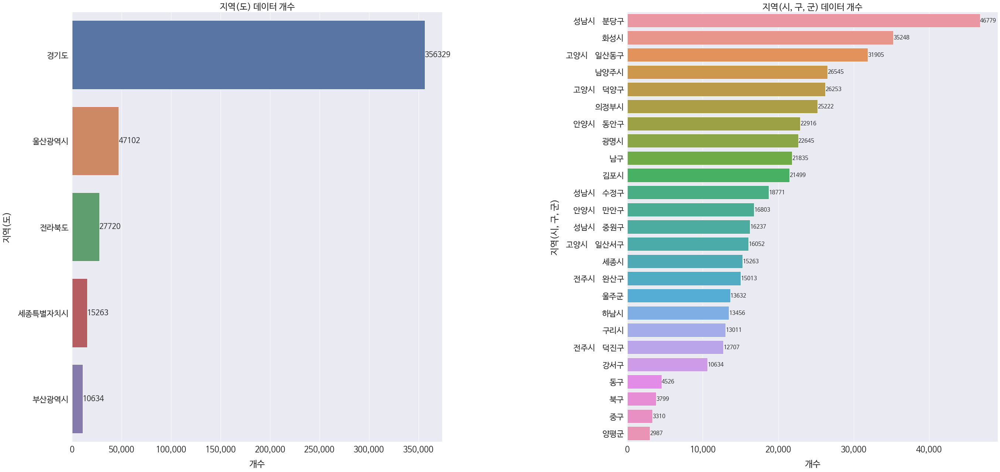

In [ ]:
f, ax = plt.subplots(1, 2, figsize=(40, 20))

sns.countplot(y='region1', data=df, ax=ax[0], order=df_region1.index)
ax[0].set_title('지역(도) 데이터 개수')
ax[0].set_xlabel('개수', labelpad=15)
ax[0].set_ylabel('지역(도)', labelpad=15)
ax[0].get_xaxis().set_major_formatter(
    mticker.FuncFormatter(lambda x, p: format(int(x), ',')))
for i in range(df_region1.shape[0]):
    ax[0].text(y=i, x=df_region1[i], s=df_region1[i],
               verticalalignment='center', fontsize=20)
    
sns.countplot(y='region2', data=df, ax=ax[1], order=df_region2.index)
ax[1].set_title('지역(시, 구, 군) 데이터 개수')
ax[1].set_xlabel('개수', labelpad=15)
ax[1].set_ylabel('지역(시, 구, 군)', labelpad=15)
ax[1].get_xaxis().set_major_formatter(
    mticker.FuncFormatter(lambda x, p: format(int(x), ',')))
for i in range(df_region2.shape[0]):
    ax[1].text(y=i, x=df_region2[i], s=df_region2[i],
               verticalalignment='center', fontsize=15)
    
plt.subplots_adjust(wspace=0.5)
plt.show()

* 경기도 데이터는 전체 데이터의 80%를 차지하고 있음.
* 경기도 안에서 성남시 분당구, 화성시, 고양시 순으로 가장 많음
* 나머지 '광역시, 도'들은 데이터 개수가 현저하게 적음

## 3.2 Age Group 시각화

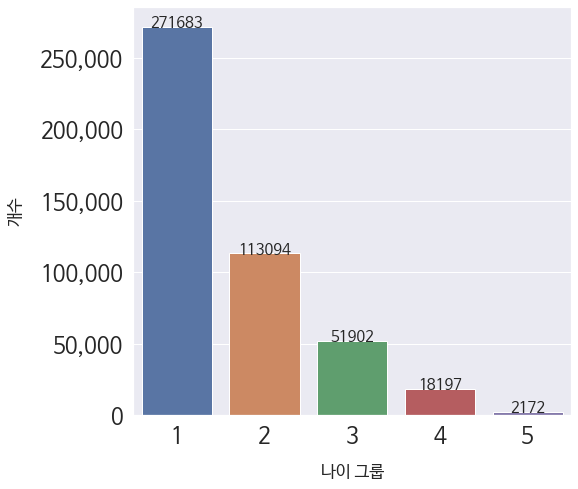

In [ ]:
age_group = list(df['age_group'].value_counts())

f, ax = plt.subplots(figsize=(7, 7))
g = sns.countplot('age_group', data=df)
g.set_xlabel('나이 그룹', labelpad=15, size='x-small')
g.set_ylabel('개수', labelpad=15, size='x-small')
g.get_yaxis().set_major_formatter(
    mticker.FuncFormatter(lambda y, p: format(int(y), ',')))

for i in range(5):
    g.text(x=i, y=age_group[i], s=age_group[i],
           horizontalalignment='center', fontsize=15)  
      
plt.show()

* 20대 사용자가 현저하게 많음. 그다음으로는 30대 사용자

## 3.3 Gender 시각화

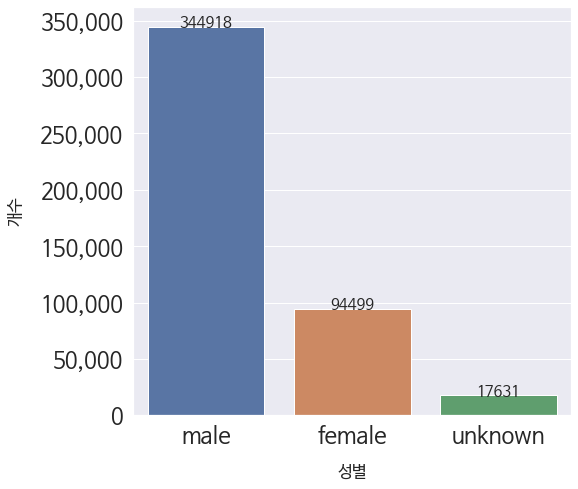

In [ ]:
gender = df['gender'].value_counts()

f, ax = plt.subplots(figsize=(7, 7))
g = sns.countplot('gender', data=df)
g.set_xlabel('성별', labelpad=15, size='x-small')
g.set_ylabel('개수', labelpad=15, size='x-small')
g.get_yaxis().set_major_formatter(
    mticker.FuncFormatter(lambda y, p: format(int(y), ',')))

for i in range(gender.shape[0]):
    g.text(x=i, y=gender[i], s=gender[i],
           horizontalalignment='center', fontsize=15)
plt.show()

* 남성 사용자가 대부분이며, `unknown`이라는 탈퇴회원도 존재함

## 3.3.1 Gender 별 사용시간

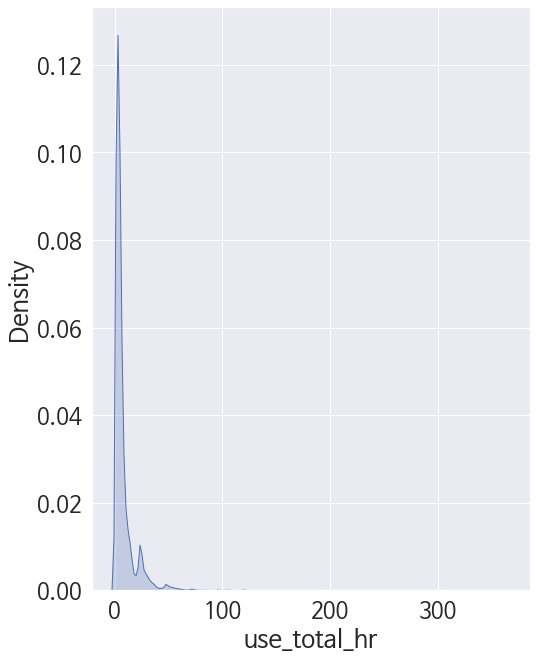

In [ ]:
f, ax = plt.subplots(figsize=(7, 10))
g = sns.kdeplot(x='use_total_hr', data=df, shade=True)

## 3.4 자동차 모델 시각화

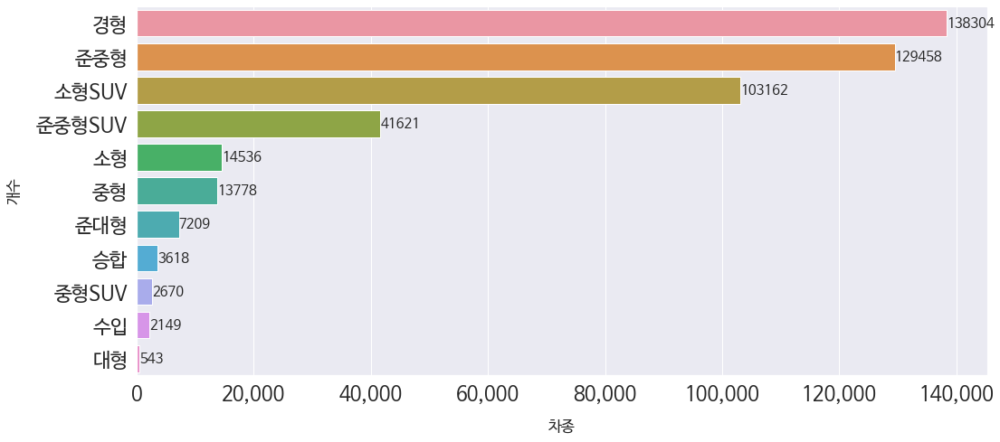

In [ ]:
car_model = df['car_model'].value_counts()

f, ax = plt.subplots(figsize=(15, 7))
g = sns.countplot(y='car_model', data=df, order=df['car_model'].value_counts().index)
g.set_xlabel('차종', labelpad=15, size='x-small')
g.set_ylabel('개수', labelpad=15, size='x-small')
g.get_xaxis().set_major_formatter(
    mticker.FuncFormatter(lambda x, p: format(int(x), ',')))

for i in range(car_model.shape[0]):
    g.text(y=i, x=car_model[i], s=car_model[i],
           verticalalignment='center', fontsize=15)
    
plt.show()    

* 전체 회원은 경형차를 가장 많이 이용함. 그다음은 준중형, 소형SUV 순
* 아무래도 편하게 탈 수 있는 차종을 선호하는 것 같다.

### 3.4.1 성별 그룹 & 자동차 모델

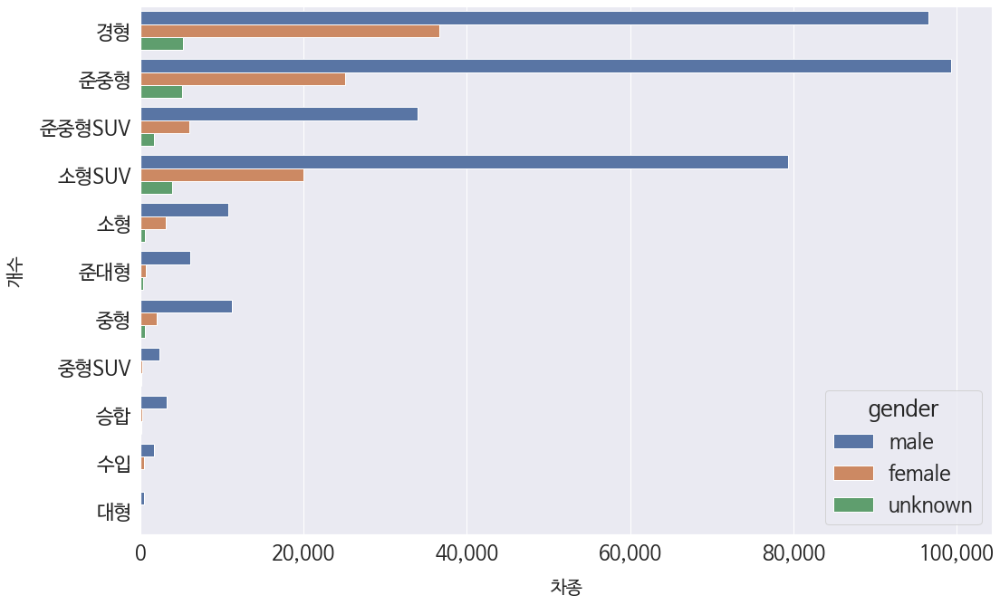

In [ ]:
f, ax = plt.subplots(figsize=(15, 10))
g = sns.countplot(y='car_model', hue='gender', data=df)
g.set_xlabel('차종', labelpad=15, size='small')
g.set_ylabel('개수', labelpad=15, size='small')
g.get_xaxis().set_major_formatter(
    mticker.FuncFormatter(lambda x, p: format(int(x), ',')))

* 남성의 경우, 준중형을 가장 많이 이용했다.
* 여성의 경우, 경형을 제일 많이 이용했다.
* 아무래도 남성이 체격이 큰편인 경우가 많으니 준중형을 선호하는 것 같다.

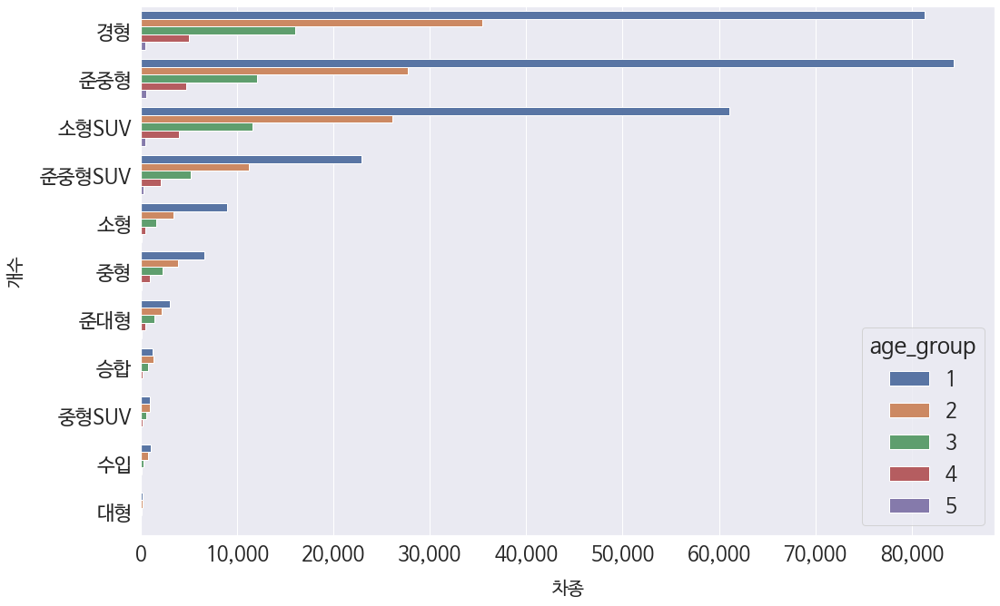

In [ ]:
f, ax = plt.subplots(figsize=(15, 10))
g = sns.countplot(y='car_model', hue='age_group', data=df, order=df['car_model'].value_counts().index)
g.set_xlabel('차종', labelpad=15, size='small')
g.set_ylabel('개수', labelpad=15, size='small')
g.get_xaxis().set_major_formatter(
    mticker.FuncFormatter(lambda x, p: format(int(x), ',')))